# Problem Statement 

Businesses need to understand customer behavior to improve profits, enhance customer service, and minimize customer churn. With a dataset containing detailed information about customers, transactions, and products—such as demographics, purchase history, and feedback—multiple factors influencing customer spending, loyalty, and purchasing behavior can be analyzed.

To address this, the aim is to predict Customer Lifetime Value (CLV) using data-driven methods. This involves leveraging machine learning techniques to segment customers into Gold, Silver, and Bronze categories based on their CLV. 


# Goal

The goal is to analyze the given customer dataset, predict Customer Lifetime Value (CLV), and segment customers into Gold, Silver, and Bronze categories using the RFM (Recency, Frequency, Monetary) approach.

# Data Acquisition

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn

import warnings
warnings.filterwarnings('ignore')

data = pd.read_csv('/Users/tarunkumararya/CLV_Project_ML/new_retail_data.csv', low_memory=False)
data.head()


,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,...,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,...,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,...,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,Shane85@gmail.com,8.362160e+09,4133 Young Canyon,Geelong,New South Wales,75929.0,Australia,...,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,Mary34@gmail.com,2.776752e+09,8148 Thomas Creek Suite 100,Edmonton,Ontario,88420.0,Canada,...,2466.854021,Home Decor,Home Depot,Tools,Excellent,Standard,PayPal,Processing,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,Charles30@gmail.com,9.098268e+09,5813 Lori Ports Suite 269,Bristol,England,48704.0,UK,...,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302010 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    301677 non-null  float64
 1   Customer_ID       301702 non-null  float64
 2   Name              301628 non-null  object 
 3   Email             301663 non-null  object 
 4   Phone             301648 non-null  float64
 5   Address           301695 non-null  object 
 6   City              301762 non-null  object 
 7   State             301729 non-null  object 
 8   Zipcode           301670 non-null  float64
 9   Country           301739 non-null  object 
 10  Age               301837 non-null  float64
 11  Gender            301693 non-null  object 
 12  Income            301720 non-null  object 
 13  Customer_Segment  301795 non-null  object 
 14  Date              301651 non-null  object 
 15  Year              301660 non-null  float64
 16  Month             30

In [6]:
#Checking missing Values in the Each Columns

data.isnull().sum()

Transaction_ID      333
Customer_ID         308
Name                382
Email               347
Phone               362
Address             315
City                248
State               281
Zipcode             340
Country             271
Age                 173
Gender              317
Income              290
Customer_Segment    215
Date                359
Year                350
Month               273
Time                350
Total_Purchases     361
Amount              357
Total_Amount        350
Product_Category    283
Product_Brand       281
Product_Type          0
Feedback            184
Shipping_Method     337
Payment_Method      297
Order_Status        235
Ratings             184
products              0
dtype: int64

In [7]:
# Calculating the percentage of the Null Values in each column based on which we decide how to handle the missing values
data.isnull().sum()/len(data)*100

Transaction_ID      0.110261
Customer_ID         0.101983
Name                0.126486
Email               0.114897
Phone               0.119864
Address             0.104301
City                0.082116
State               0.093043
Zipcode             0.112579
Country             0.089732
Age                 0.057283
Gender              0.104963
Income              0.096023
Customer_Segment    0.071190
Date                0.118870
Year                0.115890
Month               0.090394
Time                0.115890
Total_Purchases     0.119532
Amount              0.118208
Total_Amount        0.115890
Product_Category    0.093706
Product_Brand       0.093043
Product_Type        0.000000
Feedback            0.060925
Shipping_Method     0.111586
Payment_Method      0.098341
Order_Status        0.077812
Ratings             0.060925
products            0.000000
dtype: float64

Since the missing value percentage is not even 1% for any column, we can simply drop records with missing values

In [9]:
#Dropping the rows with missing values from the dataset 
data.dropna(inplace=True)

In [10]:
#Now we will check whether duplicate records are present within the data or not
data.duplicated().sum()

3

Because there are 3 duplicate values in dataset, we will drop these duplicate entries as well

In [12]:
#Dropping duplicate entries from our dataset
data.drop_duplicates(inplace=True)

In [13]:
data.head()

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,...,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,...,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,...,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,Shane85@gmail.com,8.362160e+09,4133 Young Canyon,Geelong,New South Wales,75929.0,Australia,...,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,Mary34@gmail.com,2.776752e+09,8148 Thomas Creek Suite 100,Edmonton,Ontario,88420.0,Canada,...,2466.854021,Home Decor,Home Depot,Tools,Excellent,Standard,PayPal,Processing,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,Charles30@gmail.com,9.098268e+09,5813 Lori Ports Suite 269,Bristol,England,48704.0,UK,...,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies


In [14]:
def summarize_column_uniques(dataframe):
    for column_name in dataframe.columns:
        unique_values_count = dataframe[column_name].nunique()
        print(f"Analyzing Column: {column_name}")
        print(f"Number of Unique Values: {unique_values_count}")
        
        if unique_values_count > 20:
            sample_unique_values = dataframe[column_name].unique()[:5]
            print(f"Sample of Unique Values: {sample_unique_values} ... (and more)")
        else:
            all_unique_values = dataframe[column_name].unique()
            print(f"All Unique Values: {all_unique_values}")
        
        print("-" * 80)

summarize_column_uniques(data)

Analyzing Column: Transaction_ID
Number of Unique Values: 287005
Sample of Unique Values: [8691788. 2174773. 6679610. 7232460. 4983775.] ... (and more)
--------------------------------------------------------------------------------
Analyzing Column: Customer_ID
Number of Unique Values: 86485
Sample of Unique Values: [37249. 69749. 30192. 62101. 27901.] ... (and more)
--------------------------------------------------------------------------------
Analyzing Column: Name
Number of Unique Values: 156638
Sample of Unique Values: ['Michelle Harrington' 'Kelsey Hill' 'Scott Jensen' 'Joseph Miller'
 'Debra Coleman'] ... (and more)
--------------------------------------------------------------------------------
Analyzing Column: Email
Number of Unique Values: 52530
Sample of Unique Values: ['Ebony39@gmail.com' 'Mark36@gmail.com' 'Shane85@gmail.com'
 'Mary34@gmail.com' 'Charles30@gmail.com'] ... (and more)
--------------------------------------------------------------------------------
Analyzi

Some columns in the dataset, particularly those related to personal identification, are not essential for analysis or processing. These include fields like name, email, and phone number, which serve as unique identifiers for individual customers but do not provide meaningful insights for analysis purposes. These columns are generally used for identification or communication but do not contribute to understanding customer behavior, segmenting the data, or drawing conclusions related to business trends. Therefore, they can be excluded from the analysis to focus on more relevant attributes that impact customer segmentation or other business metrics.

In [16]:
#Keeping Relevant Columns for the Data Vizualisation
data_v1 = data[['Customer_ID', 'Transaction_ID', 'Date', 'Year', 'Month', 'Time', 
          'Country', 'Age', 'Gender', 'Income', 'Customer_Segment', 
          'Total_Purchases', 'Amount', 'Total_Amount', 'Product_Category', 
          'Product_Brand', 'Product_Type', 'Ratings', 'Feedback', 
          'Shipping_Method', 'Payment_Method', 'Order_Status', 'products']]

In [17]:
# Pie charts for distribution of transactions
pie_charts = [
    ('Country', 'Distribution of transactions country-wise'),
    ('Gender', 'Distribution of transactions gender-wise'),
    ('Income', 'Distribution of transactions income-wise'),
    ('Product_Category', 'Distribution of transactions product category-wise')
]


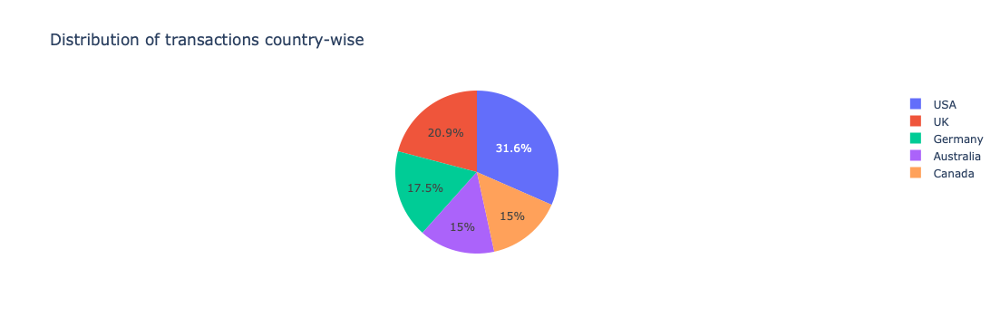

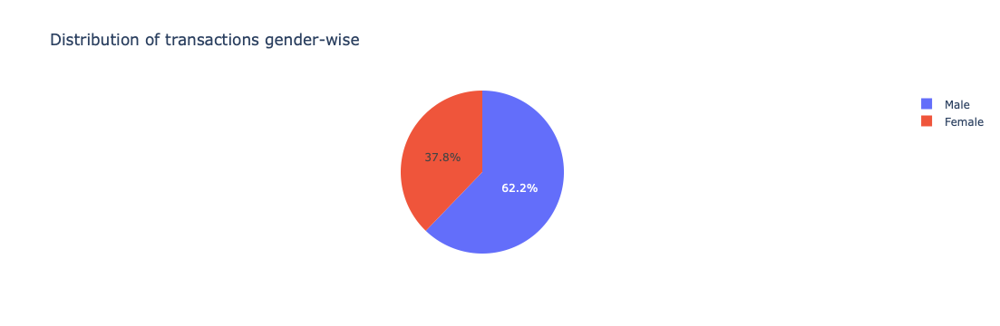

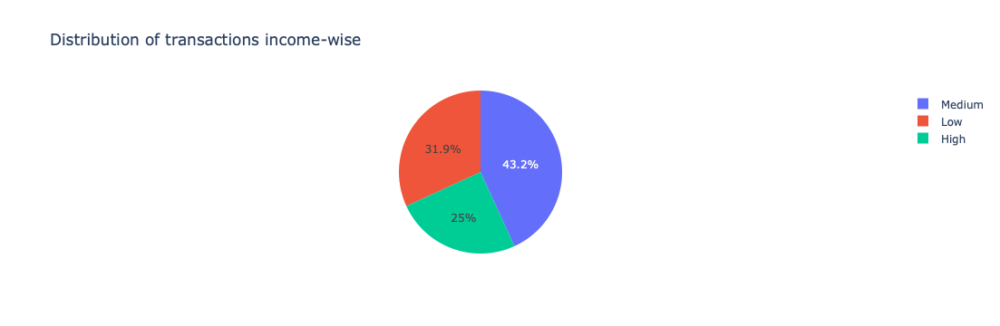

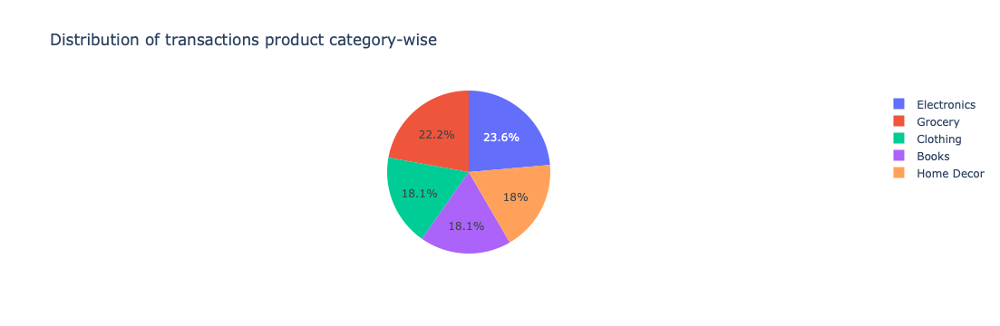

In [18]:
import plotly.express as px

for col, title in pie_charts:
    fig = px.pie(data_v1, names=col, title=title)
    fig.show()

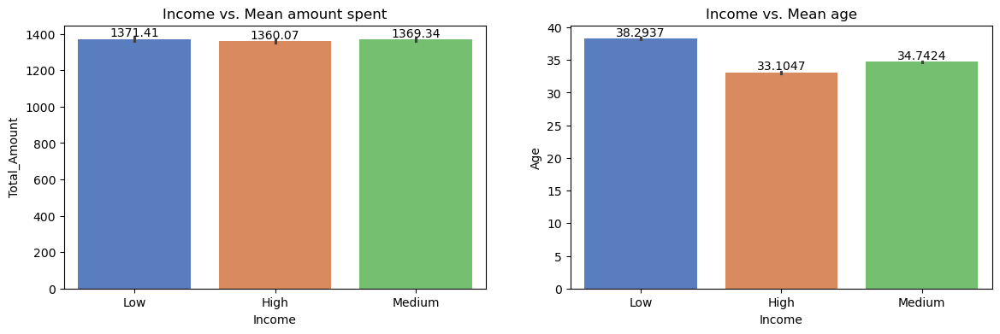

In [19]:
# Bar plots for income-related comparisons
f, axes = plt.subplots(1, 2, figsize=(14, 4))
sns.barplot(x='Income', y='Total_Amount', palette='muted', ax=axes[0], data=data_v1).set_title("Income vs. Mean amount spent")
sns.barplot(x='Income', y='Age', palette='muted', ax=axes[1], data=data_v1).set_title("Income vs. Mean age")
for ax in axes:
    for container in ax.containers:
        ax.bar_label(container)

Text(0.5, 1.0, 'Distribution of age')

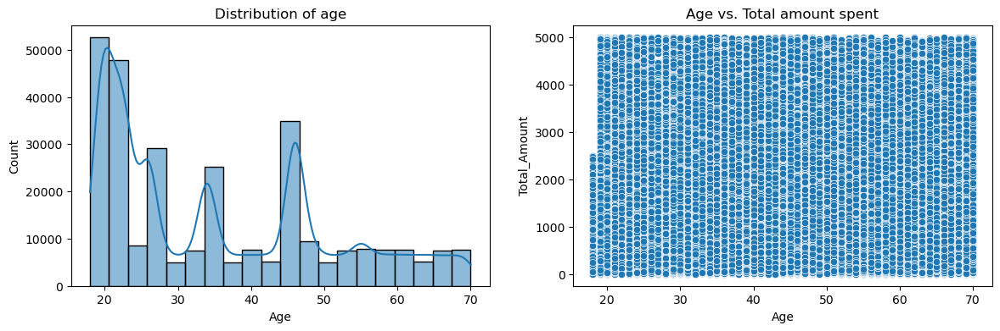

In [20]:
# Scatterplot and Histogram for Age vs Total amount and Age distribution
f, axes = plt.subplots(1, 2, figsize=(14, 4))
sns.scatterplot(x='Age', y='Total_Amount', ax=axes[1], data=data_v1).set_title("Age vs. Total amount spent")
sns.histplot(x='Age', bins=20, kde=True, ax=axes[0], data=data_v1).set_title("Distribution of age")

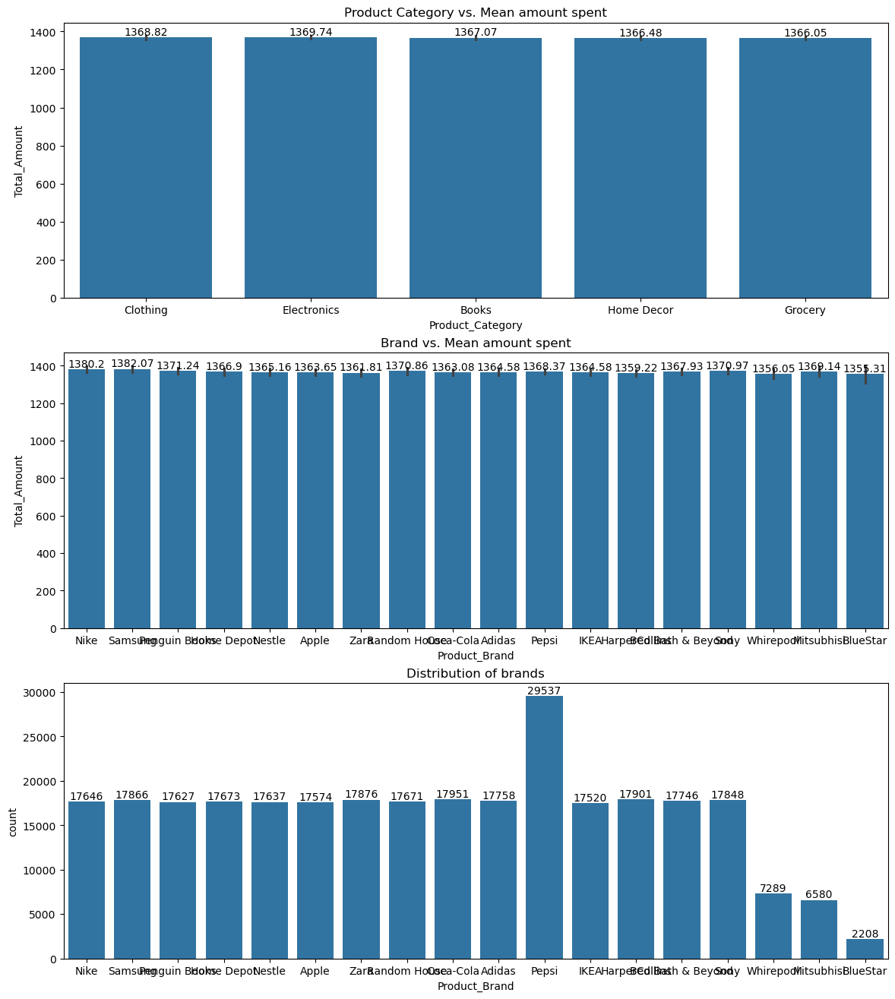

In [21]:
# Bar plots and count plots for Product Category, Brand, and Distribution
f, axes = plt.subplots(3, 1, figsize=(14, 16))
sns.barplot(x='Product_Category', y='Total_Amount', ax=axes[0], data=data_v1).set_title("Product Category vs. Mean amount spent")
sns.barplot(x='Product_Brand', y='Total_Amount', ax=axes[1], data=data_v1).set_title("Brand vs. Mean amount spent")
sns.countplot(x='Product_Brand', ax=axes[2], data=data_v1).set_title("Distribution of brands")
for ax in axes:
    for container in ax.containers:
        ax.bar_label(container)


Text(0.5, 1.0, 'Payment method vs Age')

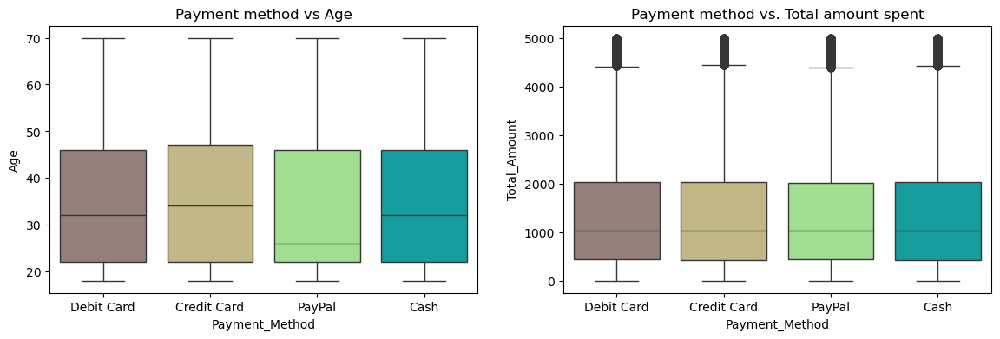

In [22]:
# Boxplots for Payment Method vs Amount and Age
f, axes = plt.subplots(1, 2, figsize=(14, 4))
sns.boxplot(x='Payment_Method', y='Total_Amount', palette='terrain_r', ax=axes[1], data=data_v1).set_title("Payment method vs. Total amount spent")
sns.boxplot(x='Payment_Method', y='Age', palette='terrain_r', ax=axes[0], data=data_v1).set_title("Payment method vs Age")

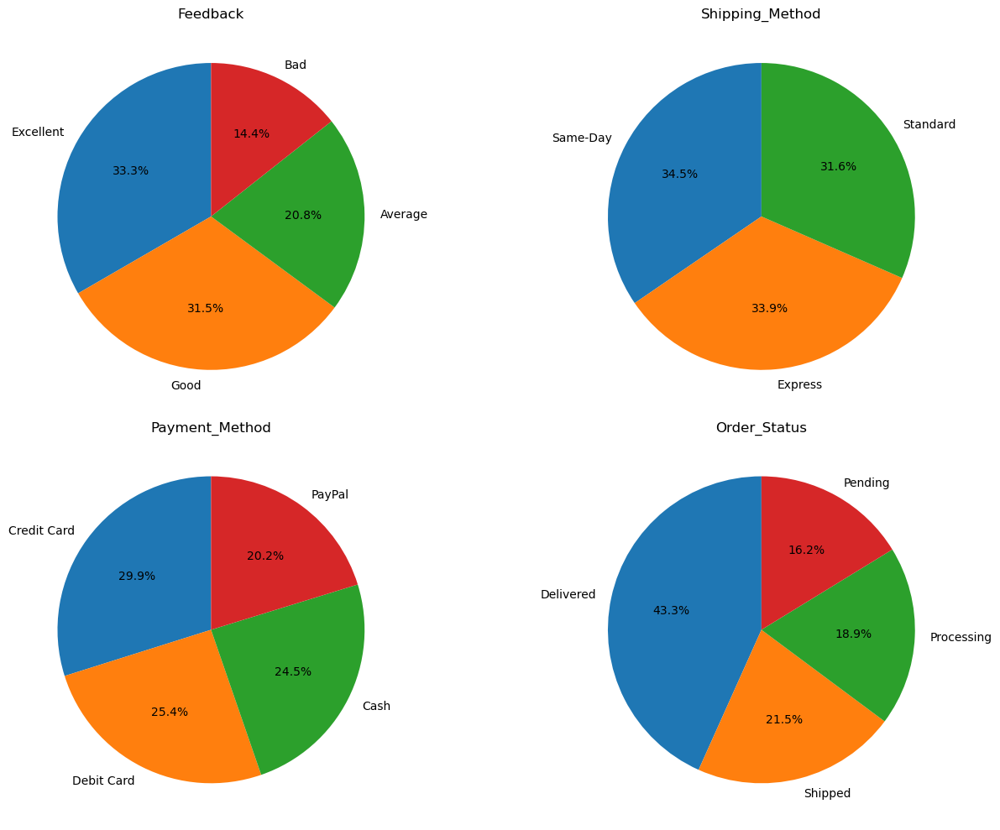

In [23]:
# Pie charts for categorical variables
categorical_columns = ['Feedback', 'Shipping_Method', 'Payment_Method', 'Order_Status']
f, axs = plt.subplots(2, 2, figsize=(14, 10))
for i, col in enumerate(categorical_columns):
    counts = data_v1[col].value_counts()
    axs.flatten()[i].pie(counts, labels=counts.index, autopct='%1.1f%%', startangle=90)
    axs.flatten()[i].set_title(col)

plt.tight_layout()
plt.show()

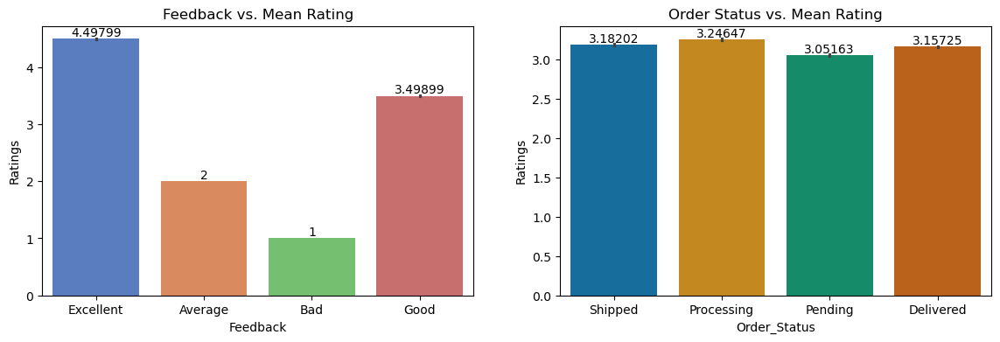

In [24]:
# Bar plots for Feedback and Order Status vs Ratings
f, axes = plt.subplots(1, 2, figsize=(14, 4))
sns.barplot(x='Feedback', y='Ratings', palette='muted', ax=axes[0], data=data_v1).set_title("Feedback vs. Mean Rating")
sns.barplot(x='Order_Status', y='Ratings', palette='colorblind', ax=axes[1], data=data_v1).set_title("Order Status vs. Mean Rating")
for ax in axes:
    for container in ax.containers:
        ax.bar_label(container)

Text(0.5, 1.0, 'Customer segment vs. Age')

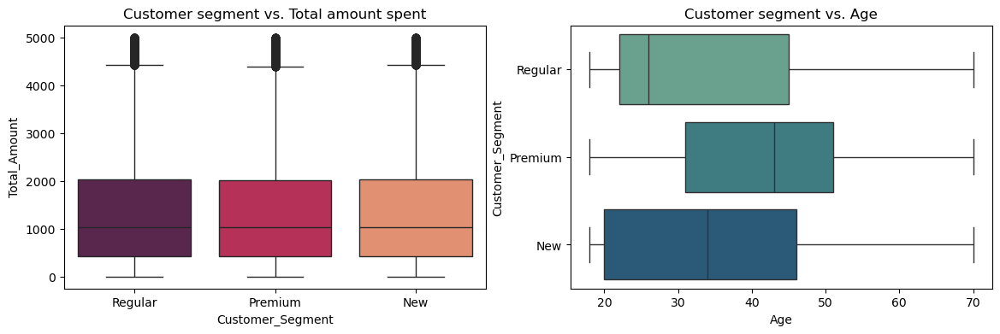

In [25]:
# Box plots for Customer Segment vs Total Amount and Age
f, axes = plt.subplots(1, 2, figsize=(14, 4))
sns.boxplot(x='Customer_Segment', y='Total_Amount', palette='rocket', ax=axes[0], data=data_v1).set_title("Customer segment vs. Total amount spent")
sns.boxplot(y='Customer_Segment', x='Age', palette='crest', ax=axes[1], data=data_v1).set_title("Customer segment vs. Age")

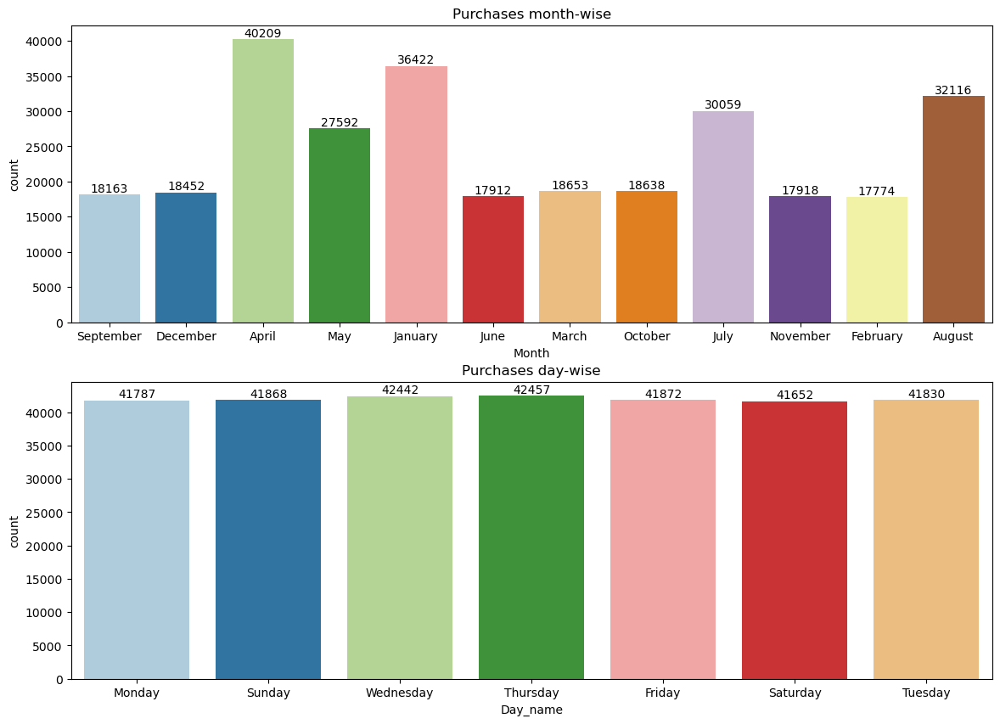

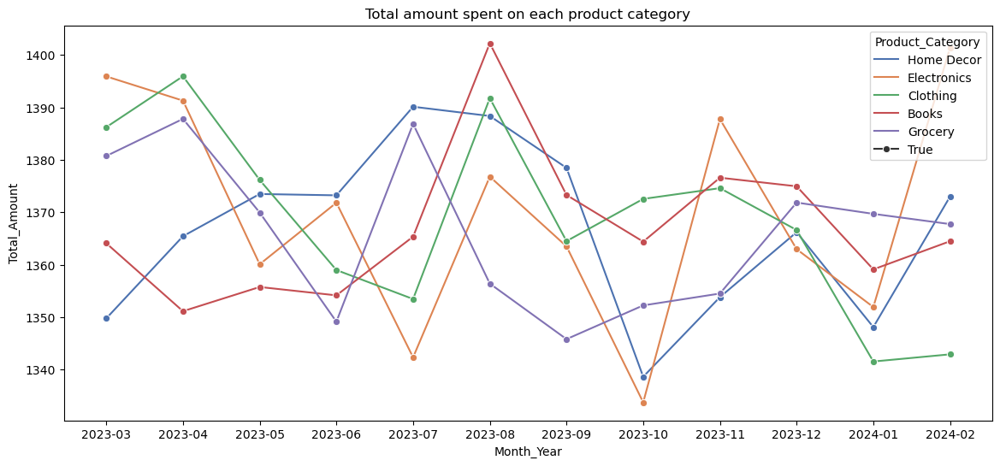

In [26]:
# Date-related processing
data_v1['Date'] = pd.to_datetime(data_v1['Date'])  # Convert Date to datetime
data_v1['Day'] = data_v1['Date'].dt.day  # Extract day from Date
data_v1['Day_name'] = data_v1['Date'].dt.day_name()  # Extract day name from Date

# Create 'Month_Year' column by extracting the month and year
data_v1['Month_Year'] = data_v1['Date'].dt.to_period('M').astype(str)

# Count plots for month-wise and day-wise purchases
f, axes = plt.subplots(2, 1, figsize=(14, 10))
sns.countplot(x='Month', palette='Paired', ax=axes[0], data=data_v1).set_title("Purchases month-wise")
sns.countplot(x='Day_name', palette='Paired', ax=axes[1], data=data_v1).set_title("Purchases day-wise")
for ax in axes:
    for container in ax.containers:
        ax.bar_label(container)

# Line plot for Total amount spent by Product Category over time
df_sorted = data_v1.sort_values('Month_Year')
plt.figure(figsize=(14, 6))
sns.lineplot(x='Month_Year', y='Total_Amount', hue='Product_Category', err_style=None, style=True, markers=True, palette='deep', data=df_sorted)
plt.title("Total amount spent on each product category")
plt.show()


# Major Inferences Drawn After Data Vizualisation


**1.Transaction Patterns**: The US accounts for the highest number of transactions, and male customers outnumber females. Among income groups, medium-income customers are making the most transactions.

**2.Age Distribution**: A large proportion of customers are under the age of 30. High-income customers tend to have a lower mean age, whereas low-income customers have a higher mean age.

**3.Payment Methods**: Credit and debit cards are the most popular payment methods, with similar average spending across all payment types. PayPal users have the lowest average age, while credit card users tend to be the oldest.

**4.Product Preferences**: Electronics are the most frequently purchased product category. Although the average spend across product categories and brands is similar, Nike leads in the number of orders, while BlueStar has the fewest.

**5.Feedback Insights**: Only 14% of the feedback is negative, indicating that most customers are satisfied.

**6.Shipping Methods**: All shipping methods show equal popularity, with the majority of orders marked as delivered. However, around 16% of orders are still pending, and these pending orders tend to have the lowest mean ratings.

**7.Monthly and Weekly Trends**: April has the highest number of transactions, followed by August. While the number of transactions is relatively consistent throughout the week, Thursday sees slightly more activity than other days. No clear seasonal trends in shopping are apparent.

**8.Customer Segments**: All customer segments exhibit similar spending behaviors. The Premium segment has the highest mean age, while the Regular segment has the lowest.

Customer segments in the current dataset do not seem to correlate with spending patterns. Therefore, we will develop a new segmentation model based on spending levels, purchase frequency, and recency.

In [29]:
# Original list of columns
original_columns = ['Customer_ID', 'Transaction_ID', 'Date', 'Year', 'Month', 'Time', 
                    'Country', 'Age', 'Gender', 'Income', 'Customer_Segment', 
                    'Total_Purchases', 'Amount', 'Total_Amount', 'Product_Category', 
                    'Product_Brand', 'Product_Type', 'Ratings', 'Feedback', 
                    'Shipping_Method', 'Payment_Method', 'Order_Status', 'products']

# Final list of columns to keep
final_columns = ['Transaction_ID', 'Customer_ID', 'Country', 'Age', 'Gender', 'Income',
                 'Customer_Segment', 'Date', 'Total_Amount', 'Product_Category', 'Product_Brand',
                 'Product_Type', 'products', 'Shipping_Method', 'Payment_Method',
                 'Order_Status', 'Ratings']

# Remove the redundant columns
columns_to_remove = [col for col in original_columns if col not in final_columns]

# Drop the redundant columns
data_v1_cleaned = data_v1.drop(columns=columns_to_remove)
data_v1_cleaned['Income'] = data_v1_cleaned['Income'].map({'Low':1, 'Medium':2, 'High':3})

# Check the final dataset
data_v1_cleaned.head()

,Customer_ID,Transaction_ID,Date,Country,Age,Gender,Income,Customer_Segment,Total_Amount,Product_Category,Product_Brand,Product_Type,Ratings,Shipping_Method,Payment_Method,Order_Status,products,Day,Day_name,Month_Year
0,37249.0,8691788.0,2023-09-18,Germany,21.0,Male,1,Regular,324.086270,Clothing,Nike,Shorts,5.0,Same-Day,Debit Card,Shipped,Cycling shorts,18,Monday,2023-09
1,69749.0,2174773.0,2023-12-31,UK,19.0,Female,1,Premium,806.707815,Electronics,Samsung,Tablet,4.0,Standard,Credit Card,Processing,Lenovo Tab,31,Sunday,2023-12
2,30192.0,6679610.0,2023-04-26,Australia,48.0,Male,1,Regular,1063.432799,Books,Penguin Books,Children's,2.0,Same-Day,Credit Card,Processing,Sports equipment,26,Wednesday,2023-04
3,62101.0,7232460.0,2023-05-08,Canada,56.0,Male,3,Premium,2466.854021,Home Decor,Home Depot,Tools,4.0,Standard,PayPal,Processing,Utility knife,8,Monday,2023-05
4,27901.0,4983775.0,2024-01-10,UK,22.0,Male,1,Premium,248.553049,Grocery,Nestle,Chocolate,1.0,Standard,Cash,Shipped,Chocolate cookies,10,Wednesday,2024-01


# Customer Segmentation

In [31]:
# Ensuring that 'Date' column is in datetime format
data_v1_cleaned['Date'] = pd.to_datetime(data_v1_cleaned['Date'])

# Setting the current date for calculation 
current_date = data_v1_cleaned['Date'].max() 

In [32]:
# selecting the relevant columns from the dataset, such as Customer_ID, Total_Amount, Date, and Transaction_ID. These columns are essential for calculating the Recency, Frequency, and Monetary metrics.
relevant_columns = ['Customer_ID', 'Total_Amount', 'Date', 'Transaction_ID']
rfm_data = data_v1_cleaned[relevant_columns]
print(rfm_data)


        Customer_ID  Total_Amount       Date  Transaction_ID
0           37249.0    324.086270 2023-09-18       8691788.0
1           69749.0    806.707815 2023-12-31       2174773.0
2           30192.0   1063.432799 2023-04-26       6679610.0
3           62101.0   2466.854021 2023-05-08       7232460.0
4           27901.0    248.553049 2024-01-10       4983775.0
...             ...           ...        ...             ...
302005      12104.0    973.962984 2024-01-20       4246475.0
302006      69772.0    285.137301 2023-12-28       1197603.0
302007      28449.0    182.105285 2024-02-27       7743242.0
302008      45477.0    120.834784 2023-09-03       9301950.0
302009      53626.0   2382.233417 2024-01-08       2882826.0

[293908 rows x 4 columns]


In [33]:
# 1. Calculate the Monetary value for each customer (Total amount spent by each customer)
# Group by 'Customer_ID' and calculate the total 'Total_Amount' for each customer
rfm_monetary = rfm_data.groupby('Customer_ID')['Total_Amount'].sum().reset_index()
rfm_monetary.columns = ['Customer_ID', 'Monetary']
rfm_monetary

,Customer_ID,Monetary
0,10000.0,5007.566357
1,10001.0,8136.462824
2,10002.0,4104.013951
3,10003.0,2340.496447
4,10004.0,2356.516683
...,...,...
86480,99995.0,9909.700258
86481,99996.0,5414.433873
86482,99997.0,6092.733546
86483,99998.0,6849.837983


In [34]:
#2. Calculate the Frequency for each customer (Number of transactions per customer)
# Count the number of 'Transaction_ID' for each customer to determine their purchase frequency
rfm_frequency = rfm_data.groupby('Customer_ID')['Transaction_ID'].count().reset_index()
rfm_frequency.columns = ['Customer_ID', 'Frequency']
rfm_frequency

,Customer_ID,Frequency
0,10000.0,4
1,10001.0,5
2,10002.0,5
3,10003.0,2
4,10004.0,2
...,...,...
86480,99995.0,8
86481,99996.0,4
86482,99997.0,4
86483,99998.0,5


In [35]:
# 3. Calculate the Recency value for each customer (Days since the last purchase)
# Calculate the difference between the most recent transaction date and the customer's last transaction date
rfm_data['Days_diff'] = max(rfm_data['Date']) - rfm_data['Date']
rfm_recency = rfm_data.groupby('Customer_ID')['Days_diff'].min().reset_index()
rfm_recency.columns = ['Customer_ID', 'Recency']
rfm_recency['Recency'] = rfm_recency['Recency'].dt.days  # Convert to number of days
rfm_recency

,Customer_ID,Recency
0,10000.0,102
1,10001.0,104
2,10002.0,94
3,10003.0,227
4,10004.0,30
...,...,...
86480,99995.0,97
86481,99996.0,63
86482,99997.0,51
86483,99998.0,4


In [36]:
# 4. Combine the RFM metrics into a single DataFrame
rfm_final = pd.merge(pd.merge(rfm_recency, rfm_frequency, on='Customer_ID', how='inner'), rfm_monetary, on='Customer_ID', how='inner')
rfm_final

,Customer_ID,Recency,Frequency,Monetary
0,10000.0,102,4,5007.566357
1,10001.0,104,5,8136.462824
2,10002.0,94,5,4104.013951
3,10003.0,227,2,2340.496447
4,10004.0,30,2,2356.516683
...,...,...,...,...
86480,99995.0,97,8,9909.700258
86481,99996.0,63,4,5414.433873
86482,99997.0,51,4,6092.733546
86483,99998.0,4,5,6849.837983


In [37]:
# 5. Outlier removal for each of the RFM features (Monetary, Recency, Frequency)
# Use Interquartile Range (IQR) method to filter out outliers for each metric
for col in ['Monetary', 'Recency', 'Frequency']:
    Q1 = rfm_final[col].quantile(0.05)  # First quartile (5th percentile)
    Q3 = rfm_final[col].quantile(0.95)  # Third quartile (95th percentile)
    IQR = Q3 - Q1  # Interquartile range
    # Filter data to keep only the values within 1.5 * IQR from Q1 and Q3
    rfm_final = rfm_final[(rfm_final[col] >= Q1 - 1.5 * IQR) & (rfm_final[col] <= Q3 + 1.5 * IQR)]

In [38]:
# 6. Standardize the RFM data (Monetary, Frequency, Recency) to bring them to the same scale
rfm_features = rfm_final[['Monetary', 'Frequency', 'Recency']]  # Select RFM columns for scaling


In [39]:
# Fit and transform the data to standardize it (mean = 0, standard deviation = 1)
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
rfm_scaled = scaler.fit_transform(rfm_features)
rfm_scaled = pd.DataFrame(rfm_scaled, columns=['Monetary', 'Frequency', 'Recency'])  # Convert to DataFrame
rfm_scaled.head()

,Monetary,Frequency,Recency
0,0.113910,0.346968,0.052294
1,1.104134,0.923585,0.075982
2,-0.172044,0.923585,-0.042457
3,-0.730156,-0.806267,1.532777
4,-0.725086,-0.806267,-0.800464


# K-Means Clustering

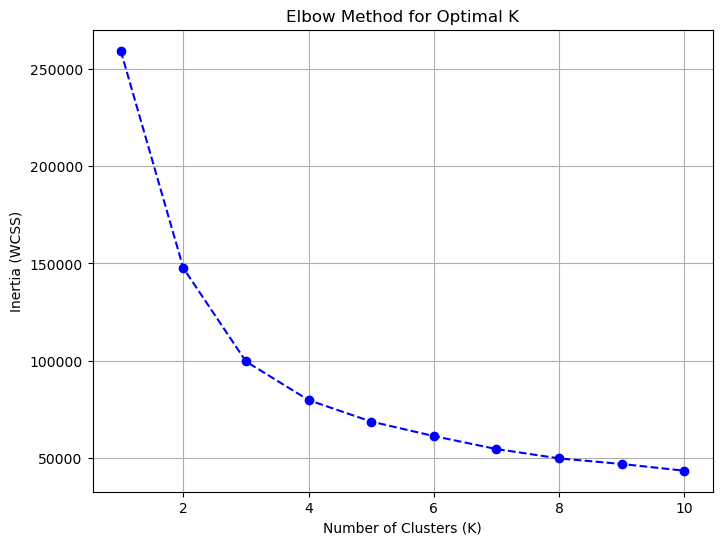

In [41]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
inertia = []  # To store the inertia (WCSS) for each K

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(rfm_scaled)  # Fit the model to the scaled RFM data
    inertia.append(kmeans.inertia_)  # Append the inertia (WCSS) for this K

# Step 2: Plot the inertia vs K values to find the elbow
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertia, marker='o', color='b', linestyle='--')
plt.title('Elbow Method for Optimal K')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Inertia (WCSS)')
plt.grid(True)
plt.show()

From the plot, the "elbow" appears to occur around K = 3, as the rate of decrease in WCSS slows significantly after this point. Therefore, **the optimal number of clusters is likely 3**.

In [43]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import davies_bouldin_score, calinski_harabasz_score

# Step 1: Perform K-Means clustering
kmeans = KMeans(n_clusters=3, max_iter=50, random_state=42)
rfm_scaled['Cluster'] = kmeans.fit_predict(rfm_scaled)  # Add cluster labels to the dataframe
rfm_scaled


,Monetary,Frequency,Recency,Cluster
0,0.113910,0.346968,0.052294,1
1,1.104134,0.923585,0.075982,2
2,-0.172044,0.923585,-0.042457,1
3,-0.730156,-0.806267,1.532777,0
4,-0.725086,-0.806267,-0.800464,1
...,...,...,...,...
86479,1.665322,2.653437,-0.006925,2
86480,0.242674,0.346968,-0.409617,1
86481,0.457340,0.346968,-0.551743,1
86482,0.696946,0.923585,-1.108405,2


In [44]:
# Step 2: Add cluster labels to the original data
rfm_final['Cluster'] = rfm_scaled['Cluster']
rfm_final

,Customer_ID,Recency,Frequency,Monetary,Cluster
0,10000.0,102,4,5007.566357,1.0
1,10001.0,104,5,8136.462824,2.0
2,10002.0,94,5,4104.013951,1.0
3,10003.0,227,2,2340.496447,0.0
4,10004.0,30,2,2356.516683,1.0
...,...,...,...,...,...
86480,99995.0,97,8,9909.700258,1.0
86481,99996.0,63,4,5414.433873,1.0
86482,99997.0,51,4,6092.733546,2.0
86483,99998.0,4,5,6849.837983,0.0


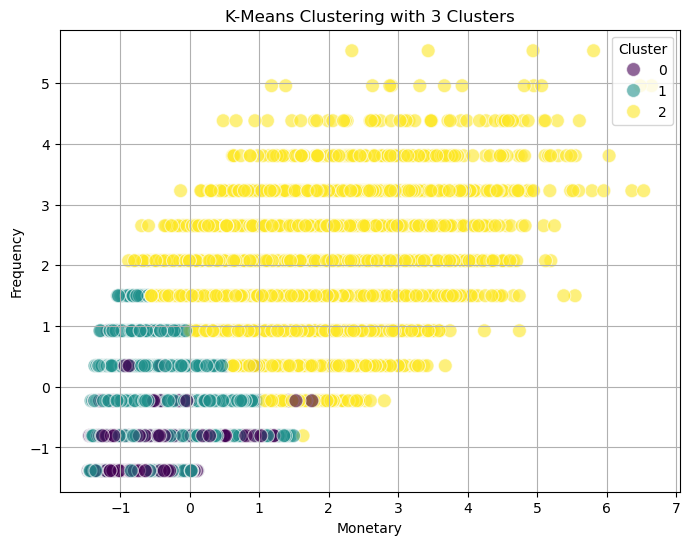

In [45]:
# Step 3: Visualizing the clusters in the original feature space (Monetary vs. Frequency)
plt.figure(figsize=(8, 6))
sns.scatterplot(data=rfm_scaled, x='Monetary', y='Frequency', hue='Cluster', palette='viridis', s=100, alpha=0.6)
plt.title('K-Means Clustering with 3 Clusters')
plt.xlabel('Monetary')
plt.ylabel('Frequency')
plt.legend(title='Cluster', loc='upper right')
plt.grid(True)
plt.show()

In [46]:
# Display cluster centers
print("Cluster Centers:\n", kmeans.cluster_centers_)

Cluster Centers:
 [[-0.68924217 -0.85348884  1.47536638]
 [-0.37793154 -0.28886982 -0.42944332]
 [ 1.18288305  1.16795804 -0.47995961]]


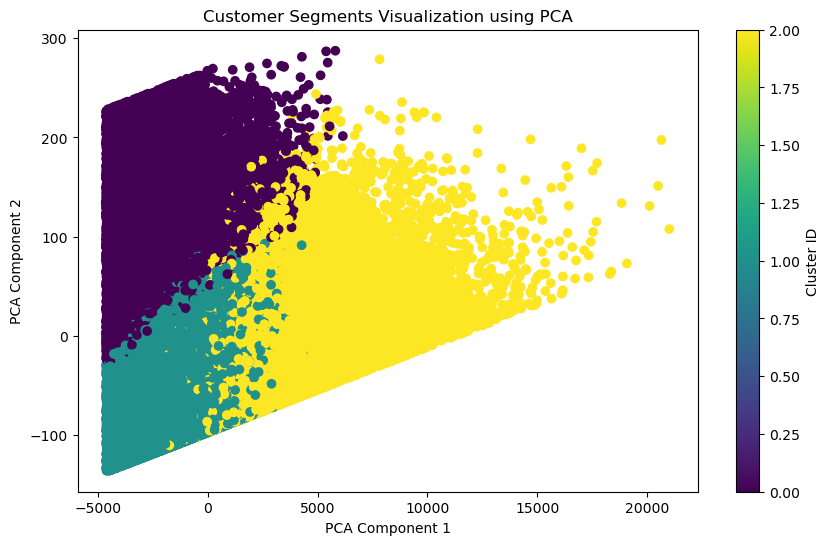

In [47]:
# Step 4: PCA for dimensionality reduction to visualize in 2D
pca = PCA(n_components=2)
pca_components = pca.fit_transform(rfm_final[['Monetary', 'Frequency', 'Recency']])  # Use relevant features

# Create a DataFrame with PCA components and Cluster IDs
clustered_df = pd.DataFrame(pca_components, columns=['PCA1', 'PCA2'])
clustered_df['Cluster'] = kmeans.labels_

# Plotting the clusters in the PCA reduced space
plt.figure(figsize=(10, 6))
plt.scatter(clustered_df['PCA1'], clustered_df['PCA2'], c=clustered_df['Cluster'], cmap='viridis')
plt.title('Customer Segments Visualization using PCA')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.colorbar(label='Cluster ID')
plt.show()

In [48]:
# Step 5: Calculate Davies-Bouldin and Calinski-Harabasz Scores
db_index = davies_bouldin_score(rfm_scaled[['Monetary', 'Frequency', 'Recency']], kmeans.labels_)
ch_index = calinski_harabasz_score(rfm_scaled[['Monetary', 'Frequency', 'Recency']], kmeans.labels_)

print(f'Davies-Bouldin Score : {db_index}')
print(f'Calinski-Harabasz Score : {ch_index}')


Davies-Bouldin Score : 0.940845390588089
Calinski-Harabasz Score : 69412.07114192033


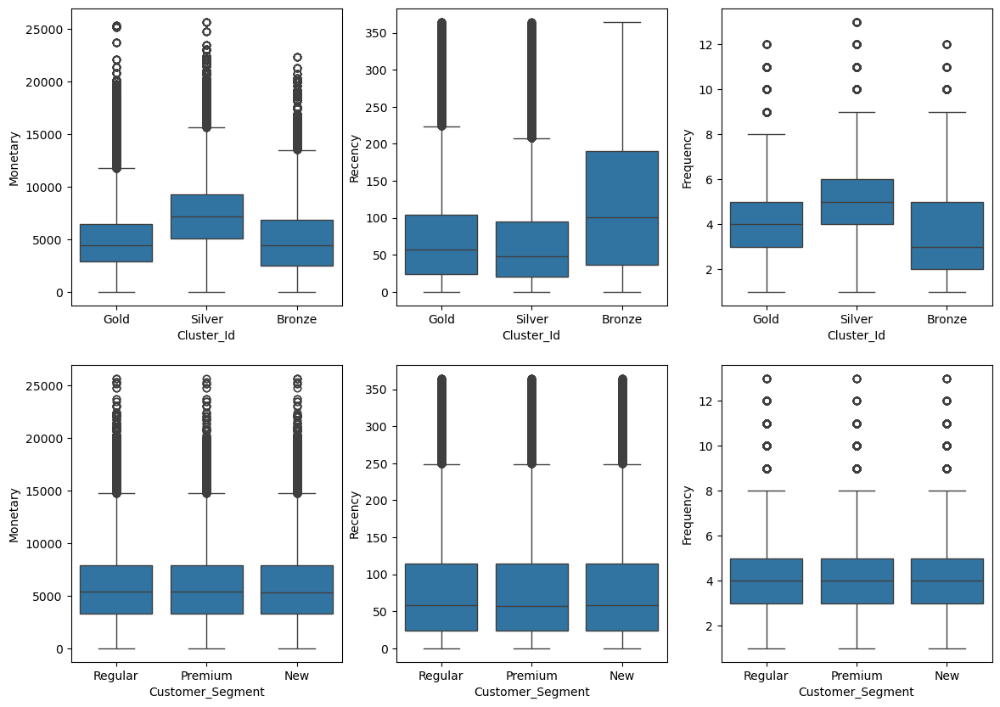

In [49]:
# Step 6: Compare with Customer Segment
given_segment = data_v1_cleaned[['Customer_ID', 'Customer_Segment']]
rfm_final_compare = pd.merge(rfm_final, given_segment, on='Customer_ID', how='inner')

# Map cluster labels to meaningful names (optional)
rfm_final_compare['Cluster_Id'] = rfm_final_compare['Cluster'].map({0: 'Bronze', 1: 'Gold', 2: 'Silver'})

# Box plot for comparing clusters and given customer segments
f, axes = plt.subplots(2, 3, figsize=(14, 10))

sns.boxplot(x='Cluster_Id', y='Monetary', data=rfm_final_compare, ax=axes[0, 0])
sns.boxplot(x='Cluster_Id', y='Recency', data=rfm_final_compare, ax=axes[0, 1])
sns.boxplot(x='Cluster_Id', y='Frequency', data=rfm_final_compare, ax=axes[0, 2])
sns.boxplot(x='Customer_Segment', y='Monetary', data=rfm_final_compare, ax=axes[1, 0])
sns.boxplot(x='Customer_Segment', y='Recency', data=rfm_final_compare, ax=axes[1, 1])
sns.boxplot(x='Customer_Segment', y='Frequency', data=rfm_final_compare, ax=axes[1, 2])

plt.show()

Based on the box plots, the data is visualized in two sets of comparisons: Cluster_Id (Gold, Silver, Bronze) and Customer_Segment (Regular, Premium, New), analyzed for three metrics — Monetary, Recency, and Frequency. 

# Analysis:

### 1. Cluster_Id Analysis:

**1. Monetary:**

- Gold and Silver customers have higher monetary values than Bronze customers.
- Gold shows the most concentrated distribution (narrower interquartile range), indicating more consistency in spending.
- Silver customers have a slightly broader spread, while Bronze has the lowest and the most dispersed monetary values.
  
**2. Recency:**

- Bronze customers have the highest recency values, with a broader spread and a higher median compared to Gold and Silver.
- Gold and Silver clusters are relatively similar in recency, indicating that these customers make purchases more frequently than Bronze.
  
**3.Frequency:**

- Gold customers exhibit the highest frequency (median and overall range), followed by Silver, with Bronze customers lagging.
- This trend aligns with monetary values, as frequent purchasers are likely contributing to higher spending.

### 2. Customer_Segment Analysis:

**1. Monetary:**

- Regular, Premium, and New customers show similar spending distributions, with no significant differences in median or interquartile range.
- This indicates that the monetary metric does not strongly differentiate between these segments.
  
**2. Recency:**

- All three segments show similar distributions of recency, with slight variations in spread but comparable medians.
- No segment stands out in terms of purchase frequency over time.
  
**3. Frequency:**

- Regular, Premium, and New customers again exhibit comparable frequency distributions.
- This suggests that customer segmentation (Regular, Premium, New) is not significantly influencing frequency behavior.

### Key Insights:

**1. Cluster_Id (Gold, Silver, Bronze) is more impactful for differentiating customer behaviors compared to Customer_Segment (Regular, Premium, New):**

- Clusters reveal clear differences in monetary, recency, and frequency, while customer segments do not show distinct patterns.
- Gold customers consistently perform better across all metrics, followed by Silver and then Bronze.
  
**2. Bronze Cluster:**

- Customers in this cluster exhibit lower spending, higher recency (indicating less frequent purchases), and lower frequency. This suggests they are less engaged customers.
  
**3. Gold Cluster:**

- Gold customers are the most valuable, with high monetary values, frequent purchases, and low recency. Retention strategies should prioritize this group.
  
**4. Customer_Segment Limitation:**

- Customer segmentation (Regular, Premium, New) does not significantly distinguish customer behavior, which may imply overlapping characteristics or insufficient differentiation criteria.

### Actionable Recommendations:

- Focus on increasing engagement and frequency among Bronze cluster customers through targeted marketing campaigns or loyalty programs.
  
- Retain Gold customers by offering exclusive perks, ensuring consistent engagement, and preventing churn.
  
- Reevaluate the definitions or criteria for Customer_Segment (Regular, Premium, New) to ensure these segments reflect meaningful behavioral differences.